Uncomment to install packages required

In [1]:
# !pip install datetime
# !pip install numpy
# !pip install pandas
# !pip install pyreadr

# !pip install matplotlib
# !pip install seaborn
# !pip install plotly

# !pip install scipy
# !pip install sklearn

Import packages

In [2]:
# Data structure manipulation packages
import datetime as dt
import numpy as np
import pandas as pd
import pyreadr as pyrr
# Visualisation packages
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
# Algorithm implementation packages
import scipy.cluster.hierarchy as sch
import scipy.spatial as ss
from sklearn.metrics import pairwise_distances

## Create a summary table for the Characteristics.csv dataset and visualise the distributions of the percentage of industrial and commercial customers, transformer ratings and transformer types.

In [3]:
# Read Characteristics.csv file into a dataframe called 'charDf'
charDf = pd.read_csv('Characteristics.csv')

# Drop duplicate rows since all columns can have only one unique value for each substation number
charDf.drop_duplicates(inplace=True)

# Summary table for charDf
display(charDf.describe())

,SUBSTATION_NUMBER,TOTAL_CUSTOMERS,Transformer_RATING,Percentage_IC,LV_FEEDER_COUNT
count,947.000000,947.000000,947.000000,947.000000,947.000000
mean,534313.835269,104.340021,389.213833,0.380165,2.761352
std,17037.240470,115.661634,287.401271,0.407173,1.898053
min,511016.000000,0.000000,0.000000,0.000000,0.000000
25%,521515.500000,3.000000,200.000000,0.010441,1.000000
50%,532652.000000,67.000000,315.000000,0.178722,3.000000
75%,552385.500000,179.500000,500.000000,0.904326,4.000000
max,564512.000000,569.000000,1000.000000,1.000000,16.000000


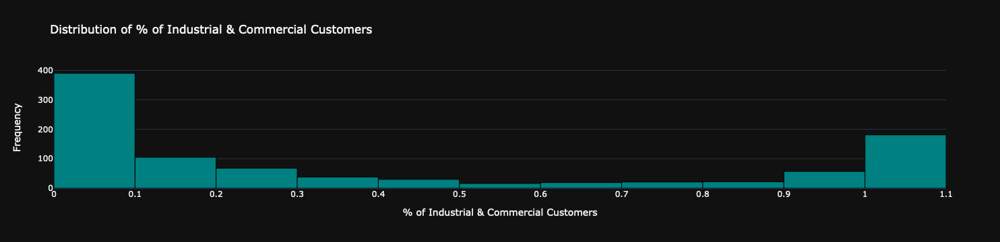

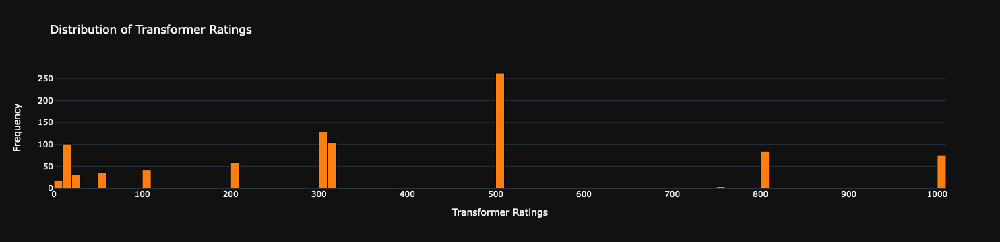

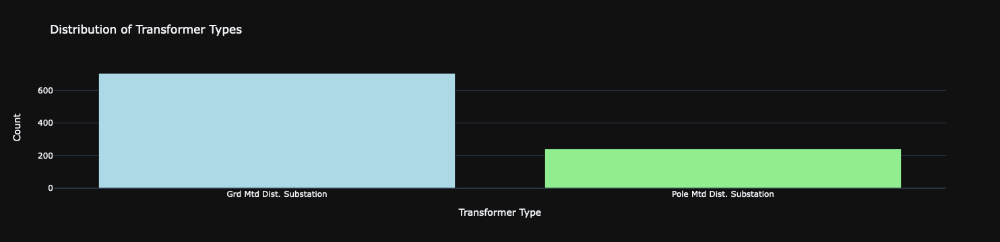

In [4]:
# Trace of histogram for 'Percentage_IC'
tracePercentage_IC = go.Histogram(x=charDf['Percentage_IC'], 
                      name='Percentage_IC', 
                      xbins=dict(start=0, 
                                 end=1.1, 
                                 size=0.1),
                      marker=dict(color='#008080', line=dict(color='black', width=1)))

# Trace of histogram for 'Transformer_RATING'
traceTransformer_RATING = go.Histogram(x=charDf['Transformer_RATING'], 
                      name='Transformer_RATING', 
                      xbins=dict(start=0, 
                                 end=1010, 
                                 size=10),
                      marker=dict(color='#ff7f0e', line=dict(color='black', width=1)))

# Trace of histogram for 'TRANSFORMER_TYPE'
traceTRANSFORMER_TYPE = go.Bar(x=charDf['TRANSFORMER_TYPE'].unique(), y=charDf['TRANSFORMER_TYPE'].value_counts(),
                               name='TRANSFORMER_TYPE', marker=dict(color=['lightblue','lightgreen'], line=dict(color='black', width=1)))

# Create the layout for the 'Percentage_IC' plot
layoutPercentage_IC = go.Layout(title='Distribution of % of Industrial & Commercial Customers',
                                xaxis=dict(title='% of Industrial & Commercial Customers', dtick=0.1),
                                yaxis=dict(title='Frequency'), template='plotly_dark')

# Create the layout for the 'Transformer_RATING' plot
layoutTransformer_RATING = go.Layout(title='Distribution of Transformer Ratings',
                                     xaxis=dict(title='Transformer Ratings', dtick=100),
                                     yaxis=dict(title='Frequency', dtick=50), template='plotly_dark')

# Create the layout for the 'TRANSFORMER_TYPE' plot
layoutTRANSFORMER_TYPE = go.Layout(title='Distribution of Transformer Types',
                                   xaxis=dict(title='Transformer Type'),
                                   yaxis=dict(title='Count'), template='plotly_dark')

# Create figures with respective traces and layouts
histPercentage_IC = go.Figure(data=[tracePercentage_IC], layout=layoutPercentage_IC)
histTransformer_RATING = go.Figure(data=[traceTransformer_RATING], layout=layoutTransformer_RATING)
barTRANSFORMER_TYPE = go.Figure(data=[traceTRANSFORMER_TYPE], layout=layoutTRANSFORMER_TYPE)

# Display all figures
histPercentage_IC.show()
histTransformer_RATING.show()
barTRANSFORMER_TYPE.show()

## Describe the relationships between the different substation characteristics (transformer type, number of customers, rating, percentage of I&C customers and number of feeders).

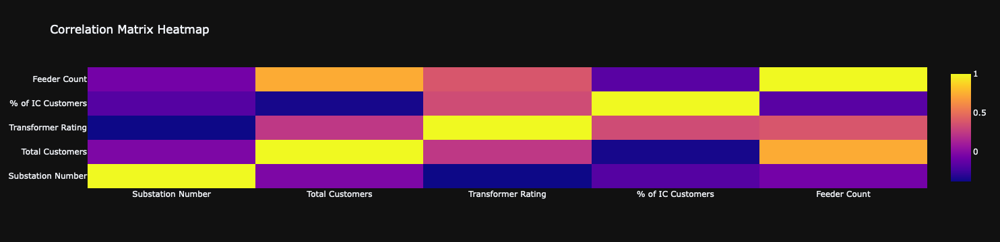

In [5]:
# Creating Correlation Matrix
correlationMatrix = charDf.corr()

heatmapFig = go.Figure(data=go.Heatmap(z=correlationMatrix,
                                       x=['Substation Number', 'Total Customers', 'Transformer Rating', '% of IC Customers','Feeder Count'],
                                       y=['Substation Number', 'Total Customers', 'Transformer Rating', '% of IC Customers','Feeder Count']))
heatmapFig.update_layout(title='Correlation Matrix Heatmap', template='plotly_dark')
heatmapFig.show()

#### The lighter the shade, higher the correlation coefficient. So we will plot Transformer Rating vs Total Customers & Feeder Count vs Total Customers. And also plot Transformer Type vs %IC Customers

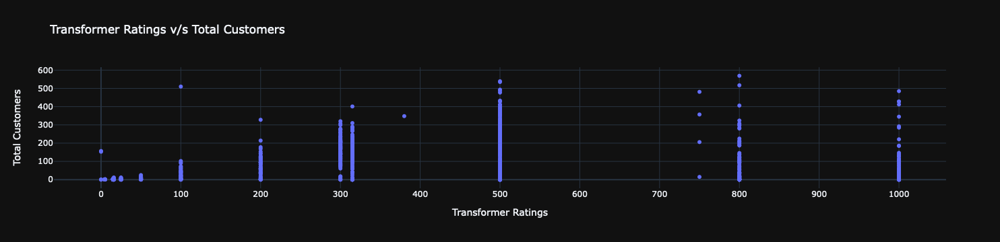

In [6]:
# Scatter plot for Transformer Ratings vs Number of Customers

traceRatingsVsCustomers = go.Scatter(x=charDf['Transformer_RATING'], y=charDf['TOTAL_CUSTOMERS'],
                                     mode='markers', name='Transformer_RATING vs TOTAL_CUSTOMERS')

layoutRatingsVsCustomers = go.Layout(title='Transformer Ratings v/s Total Customers',
                                     xaxis=dict(title='Transformer Ratings', dtick=100), yaxis=dict(title='Total Customers', dtick=100), template='plotly_dark')
figRatingsVsCustomers = go.Figure(data=[traceRatingsVsCustomers], layout=layoutRatingsVsCustomers)
figRatingsVsCustomers.show()

#### There are most customers for substations with transformer rating aroung 500 and then 800. Number of customers decrease as we go towards substations of lower power than 500 and more power than 800.

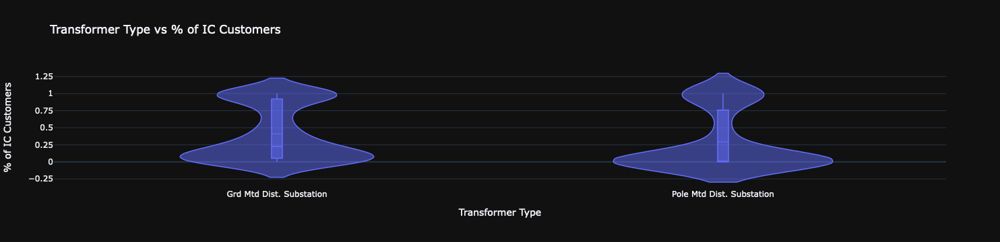

In [7]:
# Violin plot for Transformer Types vs %IC Customers

violinTraceTRANSFORMER_TYPE = go.Violin(x=charDf['TRANSFORMER_TYPE'], y=charDf['Percentage_IC'],
                                        box_visible = True, meanline_visible=True, line_width=1.5, box_width=0.05,
                                        name='TRANSFORMER_TYPE v/s Percentage_IC')
violinLayout = go.Layout(title='Transformer Type vs % of IC Customers',
                         xaxis=dict(title='Transformer Type'), yaxis=dict(title='% of IC Customers', dtick=0.25), template='plotly_dark')
violinTransformerTypeVsIC_Customers = go.Figure(data=[violinTraceTRANSFORMER_TYPE], layout=violinLayout)
violinTransformerTypeVsIC_Customers.show()

#### The probability of finding higher proportion of IC Customers is higher in Urban areas as the top part of the violin for ground-mounted substations is wider.
#### The probability of finding negligible IC Customers or rather more residential customers is higher in Rural areas as the bottom part of the violin for pole-mounted substations is wider.

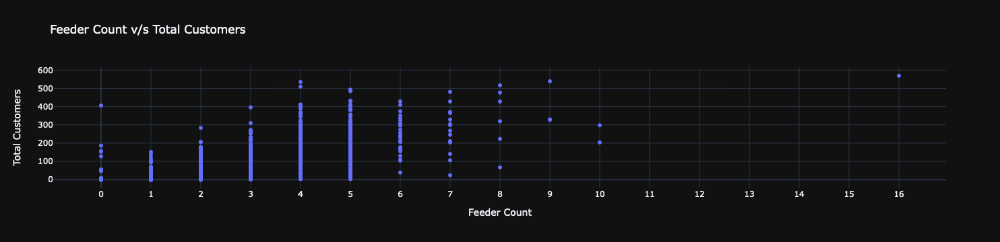

In [8]:
# Scatter plot for Feeder Count Vs Total Customers
scatterTraceFeedersVsCustomers = go.Scatter(x=charDf['LV_FEEDER_COUNT'],
            y=charDf['TOTAL_CUSTOMERS'],
            mode='markers',
            name='LV_FEEDER_COUNT vs TOTAL_CUSTOMERS')
scatterLayoutFeedersVsCustomers = go.Layout(title='Feeder Count v/s Total Customers',
                   xaxis=dict(title='Feeder Count', dtick=1),
                   yaxis=dict(title='Total Customers', dtick=100), template='plotly_dark')
scatterFeedersVsCustomers = go.Figure(data=[scatterTraceFeedersVsCustomers], layout=scatterLayoutFeedersVsCustomers)
scatterFeedersVsCustomers.show()

#### Naturally as the total customers of a substation increase, then the number of feeders from that substation rises.

## Normalize the data

In [9]:
# Read January_2013.RData as dictionary and access the key to get pandas dataframe then make 2 copies of it to process on.
jan2013df = pyrr.read_r('January_2013.RData')['January_2013']
baseDf = jan2013df.copy(deep=True)
proDf = jan2013df.copy(deep=True)

# Create a pandas series variable with maximum power value of the day
dayMaxPower = proDf.iloc[:,2:].apply(lambda row: np.max(row), axis=1)

# Loop through each power column of the duplicate data frame and divide each column by the dayMaxPower pandas series
for col in proDf.iloc[:,2:]:
    proDf[col] = proDf[col]/dayMaxPower

# Print first 2 rows of the processed data frame
proDf.head(2)

,Date,Substation,00:00,00:10,00:20,00:30,00:40,00:50,01:00,01:10,...,22:20,22:30,22:40,22:50,23:00,23:10,23:20,23:30,23:40,23:50
0,2013-01-03,511016,0.596742,0.602990,0.614149,0.610801,0.575764,0.554787,0.565276,0.535148,...,0.757867,0.769917,0.737782,0.710333,0.675073,0.686454,0.680875,0.671502,0.635126,0.603883
1,2013-01-03,511029,0.624220,0.722846,0.754057,0.643571,0.802122,0.834582,0.843321,0.818976,...,0.655119,0.630774,0.647940,0.640762,0.637328,0.659800,0.631086,0.634519,0.687266,0.680400


## Each substation has a number of days when power data were collected. In this part, we are going to calculate the average daily power demand profiles, which represent the average power produced by the substation in each 10 minute interval, across the many days of collection.

In [10]:
# Grouping the processed data frame 'proDf' by 'Substation', aggregating date by taking first date of each group and aggregating other columns by taking row-vise mean of power values and then display first 2 rows.
proDf = proDf.groupby('Substation').agg({**{col: 'mean' for col in proDf.columns[2:]}})
proDf.head(2)

,00:00,00:10,00:20,00:30,00:40,00:50,01:00,01:10,01:20,01:30,...,22:20,22:30,22:40,22:50,23:00,23:10,23:20,23:30,23:40,23:50
Substation,,,,,,,,,,,,,,,,,,,,,
511016,0.621594,0.624900,0.610020,0.599206,0.590245,0.578324,0.566139,0.553497,0.545042,0.536269,...,0.776125,0.763019,0.744475,0.739289,0.724696,0.709170,0.687730,0.670186,0.647415,0.633929
511029,0.567744,0.641737,0.675054,0.701639,0.762181,0.749306,0.733642,0.716187,0.707857,0.697664,...,0.738899,0.713231,0.681916,0.671688,0.650649,0.637245,0.622475,0.606873,0.603484,0.603634


## Create a distance matrix for these data (i.e. the averaged data created in the previous part) and produce a dendrogram by performing hierarchical clustering.

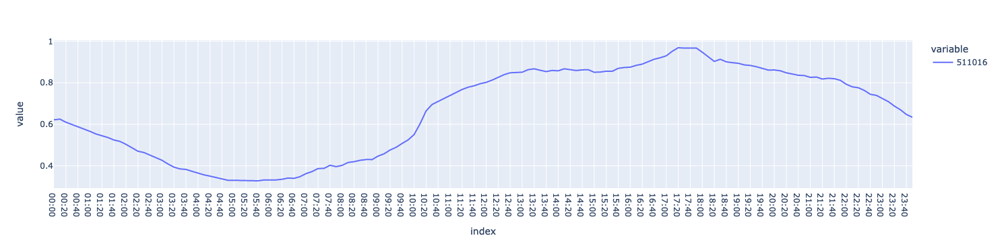

In [11]:
# Line plot of time series vs power demand of a random substation
px.line(proDf.loc[511016,'00:00':])

#### Upon checking out multiple random patterns, It is observed that there is a cyclic pattern in the power demand over 24 hours.

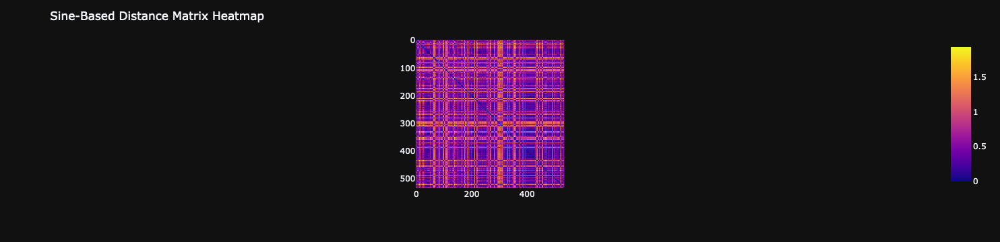

In [12]:
# Converting `Date` column to datetime object
baseDf['Date'] = pd.to_datetime(baseDf.Date, format='%Y-%m-%d')

# Define sine-based distance to use as a distance metric because the power data seems to be of cyclical pattern over the 24-hour periods.
def sinBasedDistance(x, y, period=246060):
    if np.isnan(x).any() or np.isnan(y).any(): return np.inf
    i = np.arange(len(x))
    sbd = np.mean(np.abs(np.sin(2 * np.pi * (i/period - x)) -
                         np.sin(2 * np.pi * (i/period - y))))
    return sbd

# Create distance matrix by calculating pairwise distances using custom defined distance measuring metric called sine-based distance which works well on cyclical data.
distanceMatrix = pairwise_distances(proDf, metric = sinBasedDistance, n_jobs = -1)

# Plot heatmap of the distance matrix to see any repetitive light cell patterns for potentially effective clustering
distanceMatrixHeatmap = px.imshow(distanceMatrix)
distanceMatrixHeatmap.update_layout(title='Sine-Based Distance Matrix Heatmap', template='plotly_dark')
distanceMatrixHeatmap.show()

#### There is noticeable pattern of light-coloured strips repeating in the heatmap

/var/folders/4z/fkh7ss1x1rb678dtx9g_0nvm0000gn/T/ipykernel_38865/3951936534.py:2: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



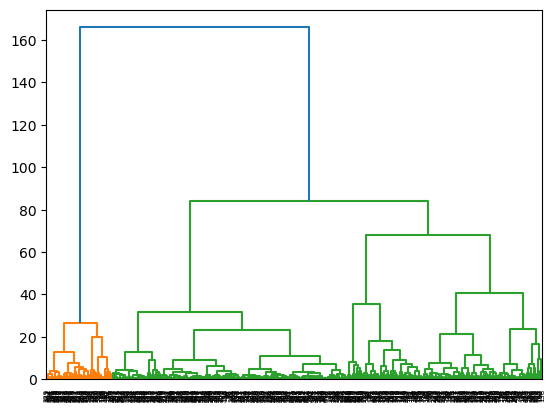

In [13]:
# Create a linkage matrix from the distance matrix using the 'ward' method which minimizes variance of inter-linkage distances
linkageMatrix = sch.linkage(distanceMatrix, method='ward')

# Create a raw dendrogram using the linkage matrix
sch.dendrogram(Z=linkageMatrix)

plt.show()

## Using the above dendrogram as a guide, choose an appropriate number of clusters and label each substation according to its cluster membership.

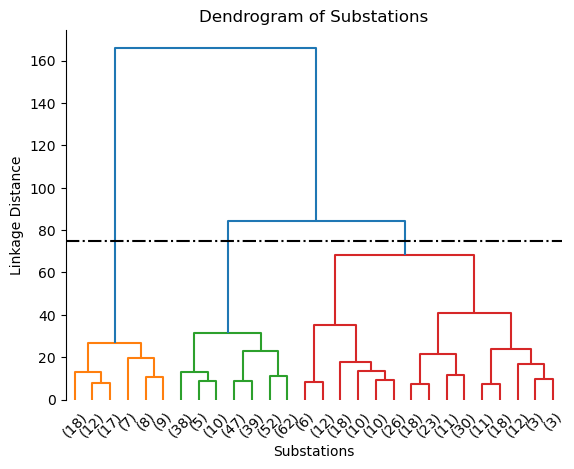

Number of substations in cluster  1 :  71
Number of substations in cluster  2 :  253
Number of substations in cluster  3 :  211


In [14]:
# Recreating a truncated dendrogram with 28 leaf nodes, 0.8 color threshold, labeled with data frame columns and leaf labels rotated by 45 degrees.
sch.dendrogram(Z=linkageMatrix, truncate_mode='lastp', p=28, color_threshold=75, leaf_rotation=45)

# Add title, axes labels, remove axes spines, add horizontal line at threshold level and display dendrogram
plt.title('Dendrogram of Substations')
plt.xlabel('Substations')
plt.ylabel('Linkage Distance')
plt.gca().spines[['top','right','bottom']].set_visible(False)
plt.axhline(y=75, color='black', linestyle='dashdot')
plt.show()

# Assign each substation to a cluster using the linkage matrix and threshold
clusters = sch.fcluster(Z=linkageMatrix, t=75, criterion='distance')

# Print the number of substations in each cluster
for c in set(clusters):
    print("Number of substations in cluster ", c, ": ", sum(clusters == c))

#### If you add all the substations in each of orange leaves, green leaves, red leaves you will get values 71, 253, 211 respectively.

## For each of the clusters, visualise the daily average demand profiles.

In [15]:
# Attach cluster number to each substation number in `substationDictionary`
substationDictionary={}
for substation, cluster in zip(proDf.index, clusters):
    substationDictionary[substation] = cluster
    
# Insert cluster column in baseDf for corresponding substation column using substationDictionary
baseDf.insert(loc=2, column = 'Cluster', value = baseDf.Substation.apply(lambda sub: substationDictionary[sub]))
baseDf.drop(columns='Substation', inplace=True)

/var/folders/4z/fkh7ss1x1rb678dtx9g_0nvm0000gn/T/ipykernel_38865/4042875775.py:5: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.



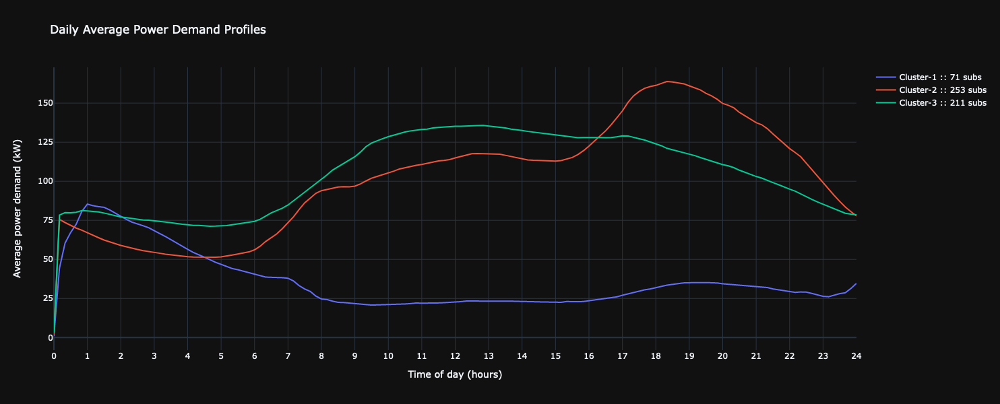

In [16]:
# Create an empty cluster traces list and iterate over each cluster
clusterTraces = []
for c in np.unique(clusters):
    # Slice cluster-specific sub df and take row-wise mean
    meanDf = baseDf[baseDf.Cluster == c].mean()
    # Select all time-series cols and convert to list
    meanData = meanDf.loc[:].tolist()
    # Create a trace on the current cluster
    clusterTrace = go.Scatter(x=[m/6 for m in range(len(meanData))],
                              y=meanData, name=f"Cluster-{c} :: {sum(clusters == c)} subs")
    # Add the trace to the appropriate list
    clusterTraces.append(clusterTrace)

# Add title, axes ticks & labels to layout and plot the clusterTraces with the layout
clusterScatterLayout = go.Layout(title = 'Daily Average Power Demand Profiles', template='plotly_dark',
                                 xaxis = dict(title = 'Time of day (hours)', dtick=1),
                                 yaxis = dict(title = 'Average power demand (kW)', dtick=25), height=600)
scatterTimeVsPower = go.Figure(data=clusterTraces, layout=clusterScatterLayout)
scatterTimeVsPower.show()

#### All 3 clusters have a steep rise in the starting hour until 1am. Cluster-2 power demand overtakes that of Cluster-3 at around 4pm-4:30pm
#### Cluster-2 has the highest power demand peaking during 6pm-7pm! Clusters - 3,4,6,7,8 gradually increase and then start decreasing.
#### Cluster-3 does not have a sharp peak but reaches it's highest demand of over 125kW and stays obve it from 10am - 6pm between 6pm-7pm.
#### Cluster-1 has the lowest power demand and nearly no activity change between 8am - 5pm.

## For each of the clusters, visualise how the demand profiles vary by weekday versus weekend.

In [17]:
# Morph baseDf by inserting `isWeekend` column using `Date` column.
# Then drop the `Date` and `Substation` columns.
baseDf.insert(loc=1, column = 'isWeekend', value = (baseDf.Date.dt.dayofweek >= 5))
baseDf.drop(columns='Date', inplace=True)

# Create an empty list to store the traces for each cluster and day of the week
weekdayTraces = []
weekendTraces = []

# Iterate over each cluster
for c in np.unique(clusters):
    clusterDf = baseDf[baseDf.Cluster == c]
    # Group the time series data isWeekend and calculate the mean power generated for each 10-minute interval
    meanDf = clusterDf.groupby('isWeekend').agg(np.mean)
    # Extract the mean power generated for each 10-minute interval on weekdays and weekends
    meanDataWeekday = meanDf.loc[False, '00:00':].tolist()
    meanDataWeekend = meanDf.loc[True, '00:00':].tolist()
    # Create a trace for the current cluster and day of the week
    weekdayTrace = go.Scatter(x=[m/6 for m in range(len(meanData))],
                              y=meanDataWeekday, name=f"Cluster-{c} :: {sum(clusters == c)} subs")
    weekendTrace = go.Scatter(x=[m/6 for m in range(len(meanData))],
                              y=meanDataWeekend, name=f"Cluster-{c} :: {sum(clusters == c)} subs")
    # Add the trace to the appropriate list
    weekdayTraces.append(weekdayTrace)
    weekendTraces.append(weekendTrace)

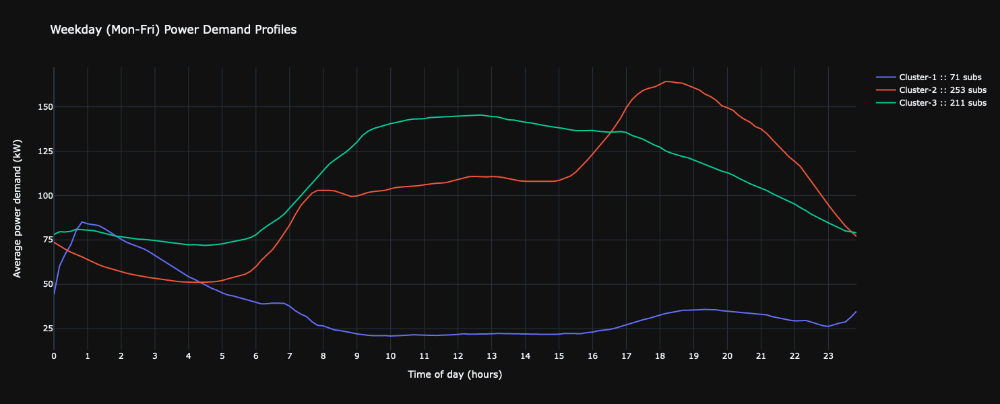

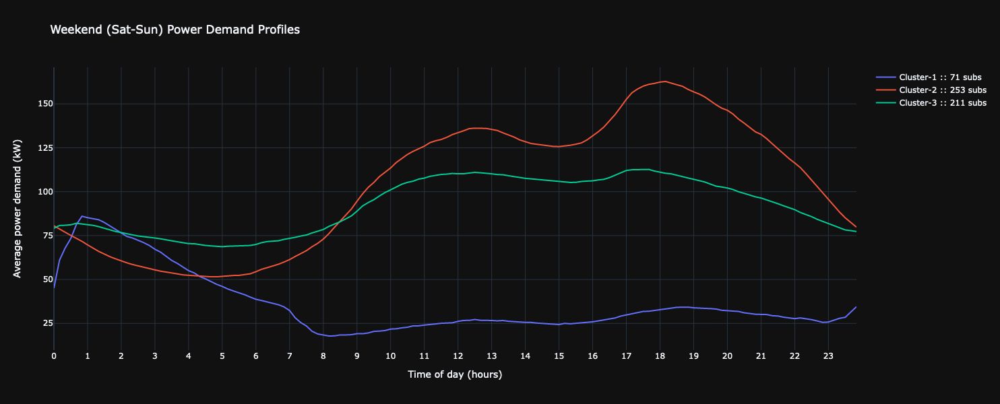

In [18]:
# Create the layout for the weekday plot
weekdayLayout = go.Layout(title = 'Weekday (Mon-Fri) Power Demand Profiles', template='plotly_dark',
                          xaxis = dict(title = 'Time of day (hours)', dtick=1),
                          yaxis = dict(title = 'Average power demand (kW)', dtick=25), height=600)
weekdayPlot = go.Figure(data=weekdayTraces, layout=weekdayLayout)
weekdayPlot.show()

# Create the layout for the weekend plot
weekendLayout = go.Layout(title = 'Weekend (Sat-Sun) Power Demand Profiles', template='plotly_dark',
                          xaxis = dict(title = 'Time of day (hours)', dtick=1),
                          yaxis = dict(title = 'Average power demand (kW)', dtick=25), height=600)
weekendPlot = go.Figure(data=weekendTraces, layout=weekendLayout)
weekendPlot.show()

#### All clusters in both the plots have ending demand same as the demand when they start their day respectively.
#### In the weekends, average power demands for Cluster-2 overtakes that of Cluster-3 at around 8:30am compared to 4:30pm during the weekdays.
#### Moreover Cluster-3 is seeing significantly decreased average power demand on weekends which could be due to high industrial or commercial customers that go off on holidays at weekend.

## Compare the characteristics data for each of the clusters.

In [19]:
# Merging both the dataframes, insert cluster column and group the data by cluster
mergedDf = proDf.reset_index().merge(charDf, left_on='Substation', right_on='SUBSTATION_NUMBER')
mergedDf.insert(loc=1, column='Cluster', value=clusters)
cluster_groups = mergedDf.groupby('Cluster')

# Calculate the mean, median, standard deviation for each characteristic for each cluster
cluster_characteristics_mean = cluster_groups[['TRANSFORMER_TYPE', 'TOTAL_CUSTOMERS', 'Transformer_RATING', 'Percentage_IC', 'LV_FEEDER_COUNT']].mean()
cluster_characteristics_median = cluster_groups[['TRANSFORMER_TYPE', 'TOTAL_CUSTOMERS', 'Transformer_RATING', 'Percentage_IC', 'LV_FEEDER_COUNT']].median()
cluster_characteristics_std = cluster_groups[['TRANSFORMER_TYPE', 'TOTAL_CUSTOMERS', 'Transformer_RATING', 'Percentage_IC', 'LV_FEEDER_COUNT']].std()

# Renaming all corresponding columns appropriately.
cluster_characteristics_mean.rename(columns={'TOTAL_CUSTOMERS':'Mean Total Customers', 'Transformer_RATING':'Average Transformer Rating',
                                             'Percentage_IC':'Average %IC', 'LV_FEEDER_COUNT':'Average Feeder Count'}, inplace=True)
cluster_characteristics_median.rename(columns={'TOTAL_CUSTOMERS':'Median Total Customers', 'Transformer_RATING':'Median Transformer Rating',
                                               'Percentage_IC':'Median %IC', 'LV_FEEDER_COUNT':'Median Feeder Count'}, inplace=True)
cluster_characteristics_std.rename(columns={'TOTAL_CUSTOMERS':'Std. in Total Customers', 'Transformer_RATING':'Std. in Transformer Rating',
                                            'Percentage_IC':'Std. in %IC', 'LV_FEEDER_COUNT':'Std. in Feeder Count'}, inplace=True)

# Display the merged data frame, mean, median, standard deviation of all characteristics of each cluster.
display(mergedDf)
display(cluster_characteristics_mean)
display(cluster_characteristics_median)
display(cluster_characteristics_std)

,Substation,Cluster,00:00,00:10,00:20,00:30,00:40,00:50,01:00,01:10,...,23:30,23:40,23:50,SUBSTATION_NUMBER,TRANSFORMER_TYPE,TOTAL_CUSTOMERS,Transformer_RATING,Percentage_IC,LV_FEEDER_COUNT,GRID_REFERENCE
0,511016,3,0.621594,0.624900,0.610020,0.599206,0.590245,0.578324,0.566139,0.553497,...,0.670186,0.647415,0.633929,511016,Grd Mtd Dist. Substation,206,750.0,0.703084,5,ST187800775900
1,511029,3,0.567744,0.641737,0.675054,0.701639,0.762181,0.749306,0.733642,0.716187,...,0.606873,0.603484,0.603634,511029,Grd Mtd Dist. Substation,268,500.0,0.160298,3,ST188200771500
2,511030,3,0.606546,0.587527,0.565728,0.546166,0.531268,0.523113,0.514511,0.502865,...,0.669595,0.641035,0.628049,511030,Grd Mtd Dist. Substation,299,500.0,0.283331,5,ST187300772600
3,511033,3,0.309088,0.298178,0.309019,0.306053,0.302208,0.302189,0.305685,0.299991,...,0.339941,0.334473,0.325367,511033,Grd Mtd Dist. Substation,292,1000.0,0.731561,5,ST191000779300
4,511034,3,0.526323,0.520856,0.510002,0.508778,0.500857,0.491782,0.483720,0.483854,...,0.558547,0.548815,0.539857,511034,Grd Mtd Dist. Substation,345,1000.0,0.732522,5,ST188900778300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
530,563737,3,0.496330,0.485482,0.482636,0.473835,0.470103,0.471928,0.457661,0.444860,...,0.527506,0.514514,0.500834,563737,Pole Mtd Dist. Substation,9,50.0,0.759600,1,SS925000879700
531,564229,3,0.323278,0.311274,0.308277,0.305832,0.309283,0.313059,0.313661,0.310719,...,0.362485,0.358432,0.346668,564229,Grd Mtd Dist. Substation,18,300.0,1.000000,2,SS909600796300
532,564230,3,0.419614,0.420693,0.416135,0.412870,0.407113,0.404254,0.408907,0.439749,...,0.419213,0.417827,0.415998,564230,Grd Mtd Dist. Substation,11,500.0,0.996467,3,SS907000796500
533,564368,3,0.384170,0.387094,0.386357,0.387019,0.392359,0.397059,0.398889,0.394692,...,0.355436,0.366303,0.369557,564368,Grd Mtd Dist. Substation,0,500.0,1.000000,1,SS903500800400


,Mean Total Customers,Average Transformer Rating,Average %IC,Average Feeder Count
Cluster,,,,
1,29.028169,221.211268,0.210647,1.436620
2,177.830040,401.462451,0.148021,3.667984
3,78.966825,503.161137,0.695283,2.720379


,Median Total Customers,Median Transformer Rating,Median %IC,Median Feeder Count
Cluster,,,,
1,2.0,16.0,0.000000,1.0
2,171.0,315.0,0.082545,4.0
3,13.0,500.0,0.927811,3.0


,Std. in Total Customers,Std. in Transformer Rating,Std. in %IC,Std. in Feeder Count
Cluster,,,,
1,55.863602,350.524338,0.360480,1.143083
2,103.889167,176.200631,0.205017,1.519856
3,121.583496,304.776487,0.371646,2.047649


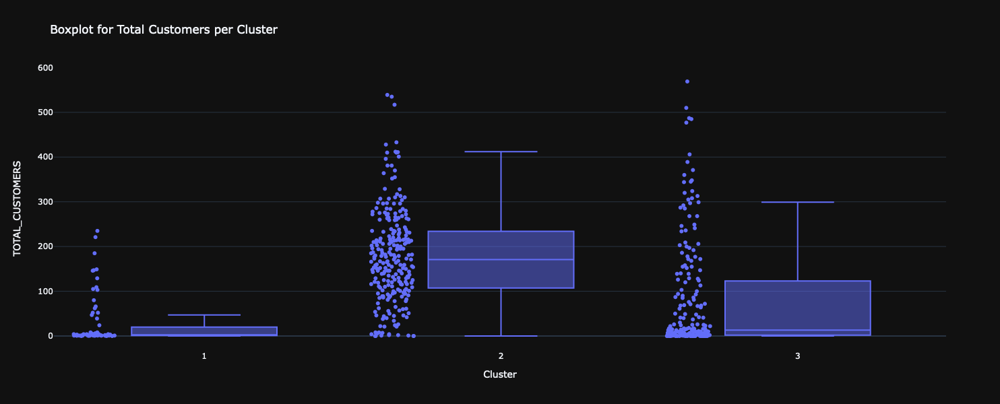

In [20]:
# Boxplot of Total Customers for each cluster
px.box(mergedDf, title='Boxplot for Total Customers per Cluster', x="Cluster", y="TOTAL_CUSTOMERS",points="all", template='plotly_dark', height=600).show()

#### Cluster-2 can be called 'Popular Cluster' as it majorly has highest customers, while Cluster-1 as 'Unpopular Cluster'

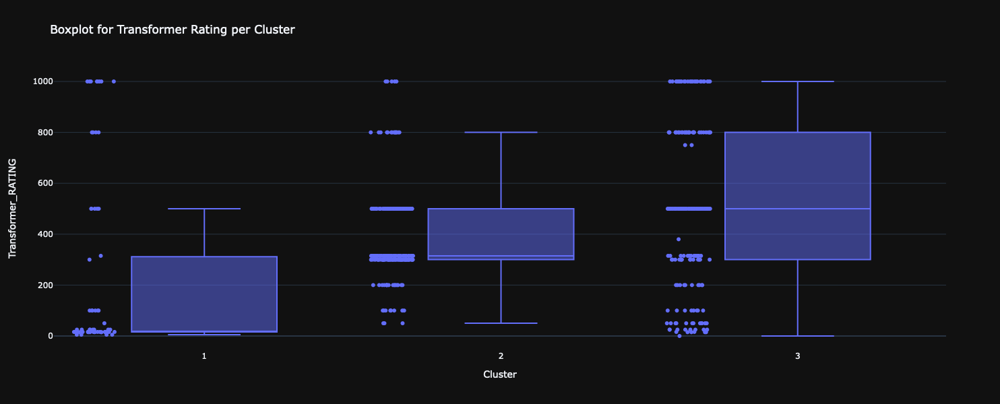

In [21]:
# Boxplot for Transformer Rating for each cluster
px.box(mergedDf, title='Boxplot for Transformer Rating per Cluster', x="Cluster", y="Transformer_RATING",points="all", template='plotly_dark', height=600).show()

#### Cluster-3 can be called 'High-Power Cluster' as it has the highest absolute power demands majorly.

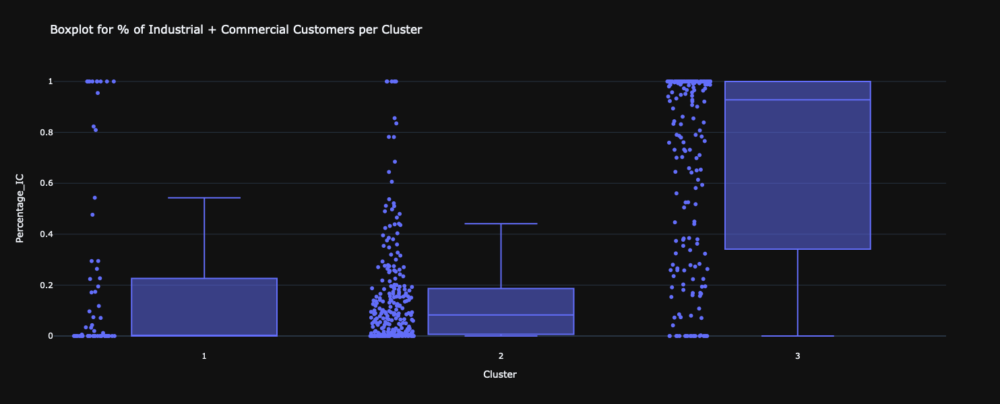

In [22]:
# Boxplot of % of Industrial & Commercial Customers for each cluster
px.box(mergedDf, title='Boxplot for % of Industrial + Commercial Customers per Cluster', x="Cluster", y="Percentage_IC",points="all", template='plotly_dark', height=600).show()

#### Cluster-3 can also be called 'Industrial & Commercial Cluster' as it clearly has the highest % of Industrial + Commercial customers. While Cluster-2 has high total customers and relatively lower % of Industrial + Commercial customers indicating that it is a 'Residential Cluster'.

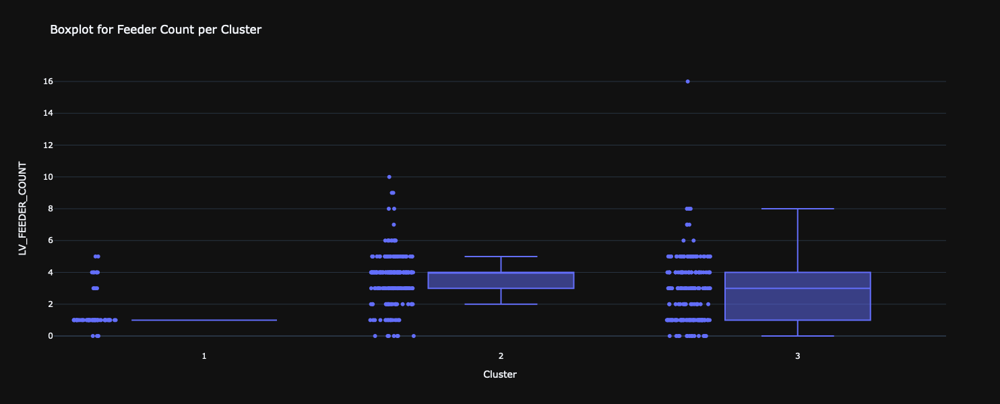

In [23]:
# Boxplot of Feeder Count for each cluster
px.box(mergedDf, title='Boxplot for Feeder Count per Cluster', x="Cluster", y="LV_FEEDER_COUNT",points="all", template='plotly_dark', height=600).show()

#### Cluster-1 can be called as 'Low-Density Cluster' as it very distinctly has less Feeder count which means low population density which also aligns with less total customers as is mentioned above.

### The most relevant names for the clusters could be as follows:-
#### Cluster-1: 'Low-Density Cluster'
#### Cluster-2: 'Residential Cluster'
#### Cluster-3: 'Industrial Cluster'

## For each substation, on the same plot, plot the daily average demand for weekdays and weekends.

In [24]:
# Read new_substations.RData as dictionary and access the key to get pandas dataframe then make a copy of it to process on.
new_substations_df = pyrr.read_r('new_substations.RData')['new_substations']
newSubsDf = new_substations_df.copy(deep=True)

# Update `Date` column to datetime series object and insert `isWeekend` boolean column.
newSubsDf['Date'] = pd.to_datetime(newSubsDf.Date, format='%Y-%m-%d')
newSubsDf.insert(loc=1, column = 'isWeekend', value = (newSubsDf.Date.dt.dayofweek >= 5))

# Group data frame by `Substation` & `isWeekend` together while aggregating using mean.
doubleGroupDf = newSubsDf.groupby(['Substation','isWeekend']).agg(np.mean)
doubleGroupDf

00:00       00:10       00:20       00:30  \
Substation isWeekend                                                   
513687     False      257.353143  259.533714  256.237714  257.344000   
           True       255.564000  256.512000  253.368000  251.028000   
521055     False       50.998857   52.068571   55.232000   52.708571   
           True        53.796000   55.632000   59.304000   55.704000   
522287     False      115.515429  113.179429  112.027429  112.713143   
           True       115.116001  113.736001  114.516001  113.580000   
525379     False      138.294857  135.542857  127.268571  125.179429   
           True       154.956000  150.804000  150.672000  147.408000   
531475     False       31.773714   31.398857   30.841143   30.582857   
           True        35.274000   33.834000   35.208000   31.536000   

                           00:40       00:50       01:00       01:10  \
Substation isWeekend                                                   
513687     False      256.928000  256.352000  257.046857  254.633143   
           True       248.448000  253.128000  253.860000  252.024000   
521055     False       49.997714   48.790857   46.573714   45.056000   
           True        53.076000   50.412000   49.356000   47.496000   
522287     False      111.556571  111.501714  111.424000  110.368000   
           True       113.196000  114.095999  114.096000  112.176001   
525379     False      121.321143  117.449143  116.036571  111.670857   
           True       140.076000  133.680000  134.484000  126.744000   
531475     False       30.742857   30.923429   30.121143   30.384000   
           True        31.116000   31.686000   29.652000   30.216000   

                           01:20       01:30  ...       22:20       22:30  \
Substation isWeekend                          ...                           
513687     False      256.210286  255.698286  ...  256.068571  257.444571   
           True       255.612000  248.412000  ...  255.096000  255.216000   
521055     False       42.692571   41.257143  ...   55.501714   53.833143   
           True        45.480000   45.144000  ...   53.880000   54.132000   
522287     False      111.702857  111.387429  ...  120.612571  119.853714   
           True       114.108000  112.836000  ...  118.560000  118.044001   
525379     False      109.334857  107.602285  ...  200.553143  198.203429   
           True       120.660000  117.876000  ...  191.028000  192.624000   
531475     False       30.662857   29.641143  ...   38.221714   37.792000   
           True        30.006000   30.354000  ...   40.164000   40.272000   

                           22:40       22:50       23:00       23:10  \
Substation isWeekend                                                   
513687     False      258.857143  260.329143  256.850286  257.933714   
           True       257.316000  255.252000  255.480000  255.960000   
521055     False       52.809143   52.676571   50.473143   48.836571   
           True        53.448000   52.464000   50.004000   48.624000   
522287     False      119.195429  119.922286  119.277714  117.897143   
           True       118.008000  118.224000  118.356001  120.828000   
525379     False      194.797714  191.972571  184.466286  172.128000   
           True       190.548000  185.832000  177.936000  172.200000   
531475     False       37.284571   37.305143   36.146286   35.689143   
           True        39.174000   38.394000   37.110000   37.380000   

                           23:20       23:30       23:40       23:50  
Substation isWeekend                                                  
513687     False      257.568000  257.677714  258.706286  257.307429  
           True       253.908000  256.464000  254.340000  251.592000  
521055     False       47.378286   45.897143   44.754286   52.918857  
           True        50.076000   47.184000   45.192000   53.748000  
522287     False      118.276571  117.270857  116.873143  116.160000  
          

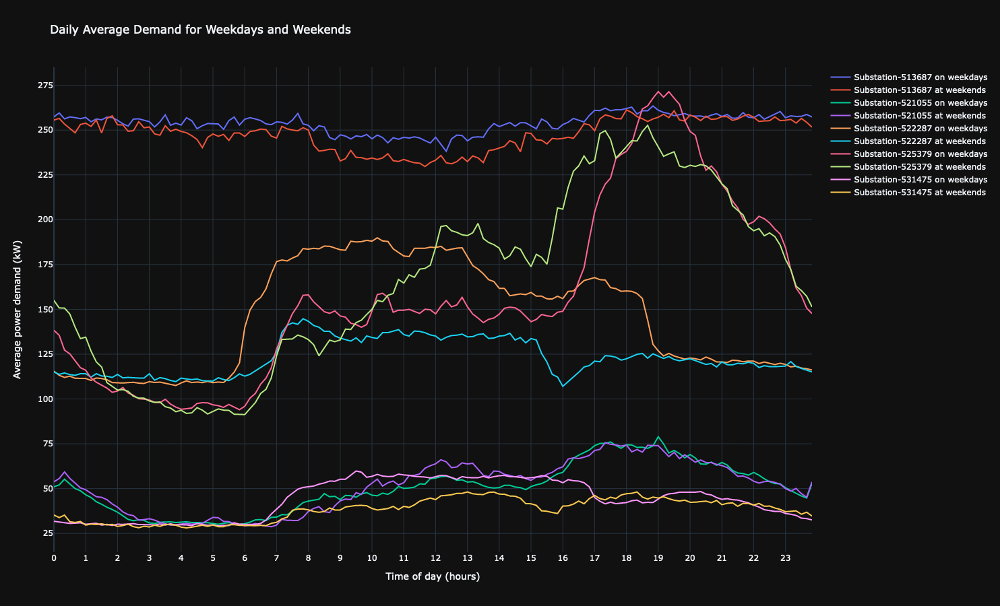

In [25]:
# Get all 5 unique substation numbers
substations = doubleGroupDf.index.get_level_values(0).unique()

tenScatterplots = go.Figure()
for substation in substations:
    weekday_data = doubleGroupDf.loc[substation, False].values
    weekend_data = doubleGroupDf.loc[substation, True].values
    tenScatterplots.add_trace(go.Scatter(x=[m/6 for m in range(len(weekday_data))], y=weekday_data, name=f'Substation-{substation} on weekdays'))
    tenScatterplots.add_trace(go.Scatter(x=[m/6 for m in range(len(weekend_data))], y=weekend_data, name=f'Substation-{substation} at weekends'))

tenScatterplots.update_layout(title = 'Daily Average Demand for Weekdays and Weekends',
                              xaxis = dict(title='Time of day (hours)', tick0=0, dtick=1), height=900, width = 1350,
                              yaxis = dict(title='Average power demand (kW)', tick0=0, dtick=25), template='plotly_dark')
tenScatterplots.show()

Total 10 curves in 1 graph - 2 curves per substation (weekday & weekend). All 10 curves distinctly coloured.

#### Substation-513687 has highest power demand throughout the week while Substations - 521055, 531475 have lowest power demand throughout the week.

## Assign each new substation to the cluster from the January 2013 data whose centroid is nearest the new substation’s daily average demand profile.

In [26]:
# Group January 2013 data frame by substations (total 535 unique) and aggregate by mean
oldSubsGroupMeanDf = jan2013df.groupby('Substation').agg(np.mean)
# Insert `Cluster` column using `clusters` labels obtained from `fcluster` function
oldSubsGroupMeanDf.insert(loc=1, column='Cluster', value=clusters)

# Calculated cluster centroids through grouping by clusters (total 3 clusters) and aggregating by mean
clusterCentroids = oldSubsGroupMeanDf.groupby('Cluster').agg(np.mean)
display(clusterCentroids) # 3 cluster-indexed rows x 144 ten-min-interval time-series

# Select the 'Substation' col + all time-series cols and then group by `Substation` aggregating with mean to calculate daily average power demands.
newSubsGroupMeanDf = newSubsDf.loc[:,'Substation':].groupby('Substation').agg(np.mean) 
display(newSubsGroupMeanDf) # 5 new substation rows x 144 ten-min-interval time-series

# Calculate Euclidean distance between each new substation's daily average power demand and each cluster's centroid
euclidianDistances = ss.distance.cdist(newSubsGroupMeanDf, clusterCentroids)

# Convert euclidian distances from numpy array to data frame for tabular view with appropriate labels.
euclidianDistDf = pd.DataFrame(euclidianDistances,
                               columns=[f'Cluster-{c}' for c in clusterCentroids.index],
                               index=[sub for sub in newSubsGroupMeanDf.index])
euclidianDistDf.reset_index(inplace=True)
euclidianDistDf.rename(columns={'index':'Substations'}, inplace=True)
print('The Euclidian Distances from Cluster Centroids are')
display(euclidianDistDf)

# Assign each new substation to the cluster whose centroid is closest.
# Then adding +1 to each cluster index (0,1,2) so that it converts to the cluster label (1,2,3) respectively.
substationAssignments = np.argmin(euclidianDistances, axis=1)+1
print(f'Substation Assignments : {list(substationAssignments)}')

,00:00,00:10,00:20,00:30,00:40,00:50,01:00,01:10,01:20,01:30,...,22:20,22:30,22:40,22:50,23:00,23:10,23:20,23:30,23:40,23:50
Cluster,,,,,,,,,,,,,,,,,,,,,
1,41.121467,55.876400,62.108258,67.031066,74.514048,78.875838,77.955002,77.367497,76.968104,75.443305,...,26.990974,26.219305,25.415803,24.497544,24.252805,25.233067,26.063465,26.561765,29.101990,32.133228
2,75.533108,73.562545,71.722103,70.013860,68.657985,67.181129,65.519454,63.902153,62.368036,61.107077,...,111.601568,107.390321,103.119485,98.930668,94.894108,90.905730,87.069880,83.459973,80.574378,77.711580
3,77.867515,79.487998,79.526761,79.794538,80.833507,80.575120,80.258957,79.956322,79.243461,78.383812,...,89.834797,88.006261,86.343298,84.912087,83.374750,81.884742,80.530116,79.091040,78.513489,78.057005


,00:00,00:10,00:20,00:30,00:40,00:50,01:00,01:10,01:20,01:30,...,22:20,22:30,22:40,22:50,23:00,23:10,23:20,23:30,23:40,23:50
Substation,,,,,,,,,,,,,,,,,,,,,
513687,256.859586,258.700138,255.446069,255.601655,254.588690,255.462621,256.167724,253.913379,256.045241,253.688276,...,255.800276,256.829793,258.432000,258.928552,256.472276,257.389241,256.558345,257.342897,257.501793,255.730759
521055,51.770483,53.051586,56.355310,53.534897,50.846897,49.238069,47.341241,45.729103,43.461517,42.329379,...,55.054345,53.915586,52.985379,52.617931,50.343724,48.777931,48.122483,46.252138,44.875034,53.147586
522287,115.405242,113.332966,112.713931,112.952276,112.008828,112.217379,112.161103,110.866759,112.366345,111.787034,...,120.046345,119.354483,118.867862,119.453793,119.023449,118.705655,118.232276,117.206069,116.686345,115.862069
525379,142.891034,139.752828,133.724690,131.311448,126.494897,121.926621,121.125517,115.828965,112.459034,110.436413,...,197.925517,196.664276,193.625379,190.278621,182.664828,172.147862,162.193655,158.419862,152.477793,148.660966
531475,32.739310,32.070621,32.045793,30.845793,30.845793,31.133793,29.991724,30.337655,30.481655,29.837793,...,38.757517,38.476138,37.805793,37.605517,36.412138,36.155586,35.745103,34.144552,34.243862,33.129931


The Euclidian Distances from Cluster Centroids are


,Substations,Cluster-1,Cluster-2,Cluster-3
0,513687,2627.893665,1840.648727,1798.200169
1,521055,362.288458,676.557784,684.494031
2,522287,1345.193299,592.982376,453.468674
3,525379,1661.721505,725.274002,825.537120
4,531475,308.758218,799.097075,769.749527


Substation Assignments : [3, 1, 3, 2, 1]


#### The 5 new substations are assigned to clusters are as follows:-
#### Substation-513687 to Cluster-3
#### Substation-521055 to Cluster-1
#### Substation-522287 to Cluster-3
#### Substation-525379 to Cluster-2
#### Substation-531475 to Cluster-1

## Based on the plots & summaries, check wheter the cluster allocation of the new substations is as expected.

#### To visualize the quality of cluster allocation of the new substations, we will scatterplot all original clusters with the new substations on 2 distant times of a daily average power demand profile.

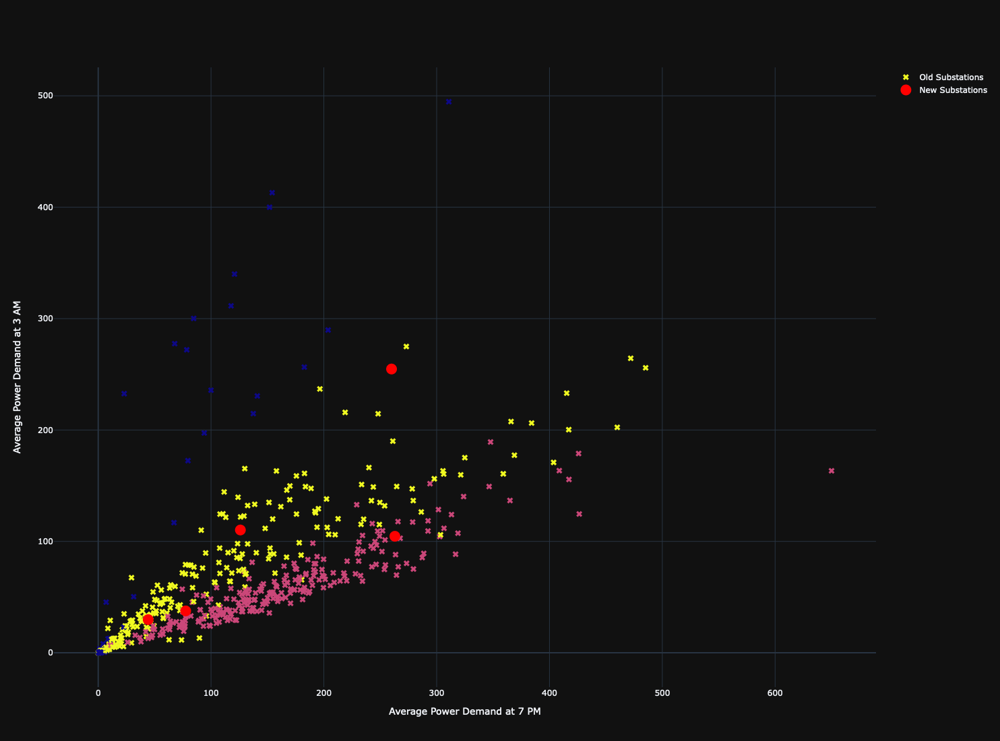

In [27]:
# Create a figure for multi-cluster scatter plot.
multiClusterScatterplot = go.Figure()
# Old substations scatter plot
multiClusterScatterplot.add_trace(go.Scatter(x=oldSubsGroupMeanDf["19:00"], y=oldSubsGroupMeanDf["02:00"],
                                             marker=dict(size=8, color=oldSubsGroupMeanDf.Cluster, symbol='x'),
                                             text=oldSubsGroupMeanDf.index, mode='markers', name='Old Substations'))
# New substations scatter plot
multiClusterScatterplot.add_trace(go.Scatter(x=newSubsGroupMeanDf["19:00"], y=newSubsGroupMeanDf["02:00"],
                                             mode='markers', marker=dict(size=16, color='red', symbol='circle'),
                                             text=newSubsGroupMeanDf.index, name='New Substations'))
# Update axis labels
multiClusterScatterplot.update_layout(xaxis_title='Average Power Demand at 7 PM',
                                      yaxis_title='Average Power Demand at 3 AM',
                                      width=1300, height=1100, template='plotly_dark')
multiClusterScatterplot.show()

#### Substations - 521055, 531475 of Cluster-1 (BLUE): unclear due to overlapped zone
#### Substations - 522287, 513687 of Cluster-3 (YELLOW): clear and distinct allocation
#### Substation - 525379 of Cluster-2 (PINK): clear and distinct allocation

## Exploring differences between years if a power company wants to know whether there are any differences between power demands across years. They may be interested in whether the groupings/clusters of substations change between years. Performing suitable analyses of the power demands by year to explore whether the membership of clusters changes across years.

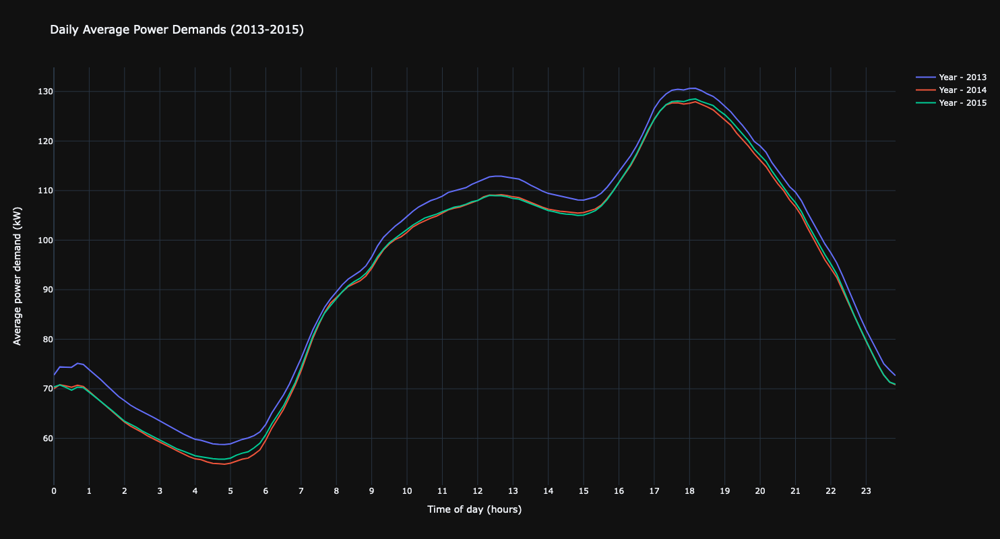

In [28]:
# Read 2014 and 2015 datasets and access their pandas dataframes respectively.
jan2014df = pyrr.read_r('January_2014.RData')['January_2014']
jan2015df = pyrr.read_r('January_2015.RData')['January_2015']

# Create deep copies of both 2014 and 2015 data frames to work on.
baseDf14, baseDf15 = jan2014df.copy(deep=True), jan2015df.copy(deep=True)

# List of lists of average power demands of each year
powerDemands = [jan2013df.loc[:,'00:00':].mean().tolist(),
                baseDf14.loc[:,'00:00':].mean().tolist(),
                baseDf15.loc[:,'00:00':].mean().tolist()]

# Initiate an empty list of traces
powerDemandTraces = []

# Iterate over daily average power demands list from 2013-2015
yearCount=2013
for powerDemand in powerDemands:
    # Create a trace for current year, append it to traces list and increment yearCount to next year
    powerDemandTrace = go.Scatter(x=[m/6 for m in range(len(powerDemand))], y=powerDemand, name=f"Year - {yearCount}")
    powerDemandTraces.append(powerDemandTrace)
    yearCount += 1
    
# Design layout for the plot
meanPowerDemandsLayout = go.Layout(title = 'Daily Average Power Demands (2013-2015)', template='plotly_dark',
                      xaxis = dict(title = 'Time of day (hours)', tick0=0, dtick=1),
                      yaxis = dict(title = 'Average power demand (kW)', tick0=0, dtick=10), height=800)

# Attach traces and layout into the figure and display it.
meanPowerDemandsFig = go.Figure(data=powerDemandTraces, layout=meanPowerDemandsLayout)
meanPowerDemandsFig.show()

#### It can be seen that daily average power demands have reduced a little after 2013 by a general difference ranging from 1-4 kW. The years 2014 and 2015 are exhibiting very similar demands with 2015 being very slightly above 2014 on an average between 12 midnight - 12 noon and 4pm - 12 midnight. 

### Some combination of possibilities that could be contributing to decrease in power demands from 2013 to 2014 & 2015 are:-

1) In terms of weather patterns, the UK has a relatively mild climate, and changes in temperature and precipitation patterns can have a significant impact on energy demand. For example, in 2014 and 2015, the UK experienced relatively mild winters, which would have led to lower heating demand compared to years with colder winters.

2) Economic conditions can also affect energy demand. For example, during periods of economic growth, energy demand may increase as more businesses and households are able to afford to consume more energy. Conversely, during periods of economic downturn, energy demand may decrease as businesses and households cut back on energy consumption. The UK economy recovered from recession in 2013 and continued to grow in 2014 and 2015, hence it is possible that some energy consumption was cut back as a result of this.

3) Regarding to the EV introduction in 2014, UK sales of electric vehicles grew rapidly from around 3,500 in 2013 to over 30,000 in 2015. This increase in EV adoption would have led to a decrease in demand for gasoline and diesel fuel, which would have led to a decrease in power demand at petrol stations and refineries, thus contributing to the lower power demand in 2014 and 2015. Additionally, EVs are also more energy-efficient than gasoline-powered vehicles, so their increased use would have contributed to overall energy efficiency.

## Hierarchical Clustering of 2014 and 2015 power data.

In [29]:
# Create deep copies of 2014 and 2015 dataframes to process on. Each called proDf14 and proDf15 respectively. (proDf meaning processed data frame)
proDf14, proDf15 = jan2014df.copy(deep=True), jan2015df.copy(deep=True)

# Create a pandas series variables with maximum power value of the day
dayMaxPower14 = proDf14.iloc[:,2:].apply(lambda row: np.max(row), axis=1)
dayMaxPower15 = proDf15.iloc[:,2:].apply(lambda row: np.max(row), axis=1)
# Loop through each power column of the data frames and divide each column by the dayMaxPower pandas series
for col in proDf14.iloc[:,2:]:
    proDf14[col] = proDf14[col]/dayMaxPower14
    proDf15[col] = proDf15[col]/dayMaxPower15

# Grouping the processed data frames `proDf14`, `proDf15` by `Substation`, aggregating date by taking first date of each group and aggregating other columns by taking row-vise mean of power valuues.
proDf14 = proDf14.groupby('Substation').agg({**{col: 'mean' for col in proDf14.columns[2:]}})
proDf15 = proDf15.groupby('Substation').agg({**{col: 'mean' for col in proDf15.columns[2:]}})

# Create distance matrices by calculating pairwise distances using custom defined distance measuring metric called sine-based distance which works well on cyclical data.
distanceMatrix14 = pairwise_distances(proDf14, metric = sinBasedDistance, n_jobs = -1)
distanceMatrix15 = pairwise_distances(proDf15, metric = sinBasedDistance, n_jobs = -1)
# Create a linkage matrices from the distance matrix using the 'ward' method which minimizes variance of inter-linkage distances
linkageMatrix14 = sch.linkage(distanceMatrix14, method='ward')
linkageMatrix15 = sch.linkage(distanceMatrix15, method='ward')
# Assign each substation of 2014, 2015 to a cluster using the linkage matrices and same threshold (75) as for 2013
clusters14 = sch.fcluster(Z=linkageMatrix14, t=75, criterion='distance')
clusters15 = sch.fcluster(Z=linkageMatrix15, t=75, criterion='distance')

# Attach a cluster number to each corresponding substation number in respective substationDictionaries of 2014 & 2015
substationDictionary14, substationDictionary15 = {}, {}
for substation, cluster in zip(proDf14.index, clusters14):
    substationDictionary14[substation] = cluster
for substation, cluster in zip(proDf15.index, clusters15):
    substationDictionary15[substation] = cluster

/var/folders/4z/fkh7ss1x1rb678dtx9g_0nvm0000gn/T/ipykernel_38865/1418754996.py:20: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix

/var/folders/4z/fkh7ss1x1rb678dtx9g_0nvm0000gn/T/ipykernel_38865/1418754996.py:21: ClusterWarning:

scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix



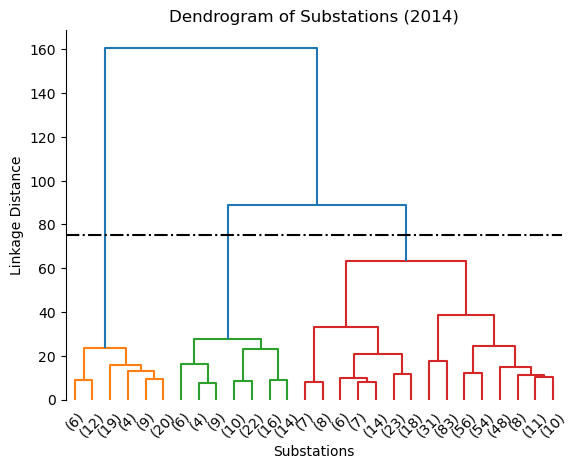

Number of substations in cluster  1 :  70
Number of substations in cluster  2 :  81
Number of substations in cluster  3 :  384


In [30]:
# Recreating a truncated dendrogram with 28 leaf nodes, 0.8 color threshold, labeled with data frame columns and leaf labels rotated by 45 degrees.
sch.dendrogram(Z=linkageMatrix14, truncate_mode='lastp', p=28, color_threshold=75, leaf_rotation=45)

# Add title, axes labels, remove axes spines, add horizontal line at threshold level and display dendrogram
plt.title('Dendrogram of Substations (2014)')
plt.xlabel('Substations')
plt.ylabel('Linkage Distance')
plt.gca().spines[['top','right','bottom']].set_visible(False)
plt.axhline(y=75, color='black', linestyle='dashdot')
plt.show()

# Print the number of substations in each cluster from 2014
for c in set(clusters14):
    print("Number of substations in cluster ", c, ": ", sum(clusters14 == c))

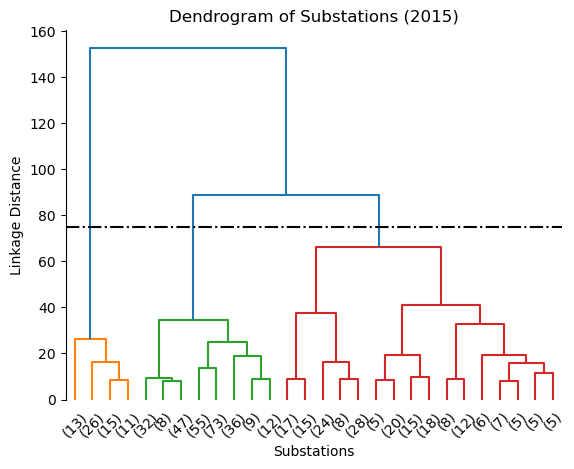

Number of substations in cluster  1 :  65
Number of substations in cluster  2 :  272
Number of substations in cluster  3 :  198


In [31]:
# Recreating a truncated dendrogram with 28 leaf nodes, 0.8 color threshold, labeled with data frame columns and leaf labels rotated by 45 degrees.
sch.dendrogram(Z=linkageMatrix15, truncate_mode='lastp', p=28, color_threshold=75, leaf_rotation=45)

# Add title, axes labels, remove axes spines, add horizontal line at threshold level and display dendrogram
plt.title('Dendrogram of Substations (2015)')
plt.xlabel('Substations')
plt.ylabel('Linkage Distance')
plt.gca().spines[['top','right','bottom']].set_visible(False)
plt.axhline(y=75, color='black', linestyle='dashdot')
plt.show()

# Print the number of substations in each cluster from 2015
for c in set(clusters15):
    print("Number of substations in cluster ", c, ": ", sum(clusters15 == c))

In [32]:
# Retrieve the substations - cluster assignments from 2013, 2014, 2015
clustering2013 = pd.DataFrame(data={'Substation':proDf.index, 'Cluster':clusters}, dtype=int)
clustering2014 = pd.DataFrame(data={'Substation':proDf14.index, 'Cluster':clusters14}, dtype=int)
clustering2015 = pd.DataFrame(data={'Substation':proDf15.index, 'Cluster':clusters15}, dtype=int)

In [33]:
# Let's comapre the cluster mean values of all the years first
print(f'2013 average cluster number: {clustering2013.Cluster.mean()}')
print(f'2014 average cluster number: {clustering2014.Cluster.mean()}')
print(f'2015 average cluster number: {clustering2015.Cluster.mean()}')

2013 average cluster number: 2.2616822429906542
2014 average cluster number: 2.586915887850467
2015 average cluster number: 2.2485981308411214


### First observation is that the initial and final values are close so the clustering dominance is of cluster-2 and is retained in 2013 and 2015. But in 2014, there is a significant increase in the average cluster number which suggests that many substations moved from cluster-1 and/or cluster-2 to cluster-3.

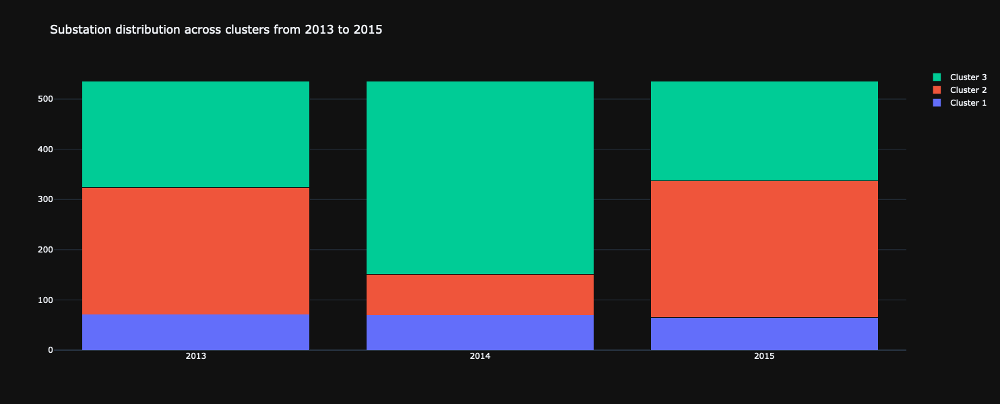

In [34]:
# Create a dictionary to store the number of substations in each cluster for each year (initiating with 0)
cluster_counts = {'2013': {1: 0, 2: 0, 3: 0},
                  '2014': {1: 0, 2: 0, 3: 0},
                  '2015': {1: 0, 2: 0, 3: 0}}

# Iterate through the dataframes and count the number of substations in each cluster for each year
for i, df in enumerate([clustering2013, clustering2014, clustering2015]):
    for c in set(df.Cluster):
        cluster_counts[f'201{i+3}'][c] = sum(df.Cluster == c)

# Create a stacked bar chart
stackedBarFig = go.Figure(data=[
    go.Bar(name='Cluster 1', x=list(cluster_counts.keys()), y=[cluster_counts[year][1] for year in cluster_counts]),
    go.Bar(name='Cluster 2', x=list(cluster_counts.keys()), y=[cluster_counts[year][2] for year in cluster_counts]),
    go.Bar(name='Cluster 3', x=list(cluster_counts.keys()), y=[cluster_counts[year][3] for year in cluster_counts])
])

# Change the bar mode, title and display.
stackedBarFig.update_layout(barmode='stack', title='Substation distribution across clusters from 2013 to 2015',
                            template='plotly_dark', height=600)
stackedBarFig.show()


#### It is now clear that the substations majorly migrated from cluster-2 to cluster-3 from 2013 to 2014 which reverted back in 2015. While cluster-1 remained stable throughout the 3 years. These cluster-2 substations were primarily serving the residential segment power demands as seen in 2013 boxplots per cluster.

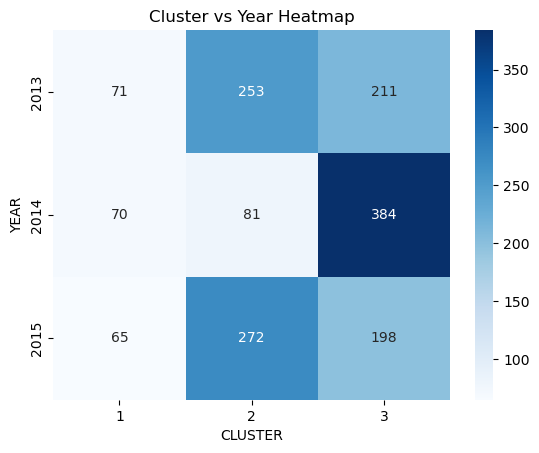

In [35]:
# Create a dataframe from the cluster_counts dictionary
counts_df = pd.DataFrame(cluster_counts).T

# Create a heatmap
heatmapAx = plt.axes()
clusterYearHeatmap = sns.heatmap(counts_df, annot=True, cmap='Blues', fmt='g',
                                 xticklabels=True, yticklabels=True, ax=heatmapAx)
# Set plot title, axes labels and display plot 
heatmapAx.set_title('Cluster vs Year Heatmap')
clusterYearHeatmap.set(xlabel='CLUSTER', ylabel='YEAR')
plt.show()

#### This heatmap gives a precise total value of how many substations (253-81=172) shifted from Cluster-2 to Cluster-3 in the year 2014. By 2015, the substations have gradually shifted from Cluster-1 and Cluster-3 to Cluster-2 since 2013.